### Notebook for calculating DEGs and scanning biological signatures in Cardiomyocytes 

- **Developed by:** Carlos Talavera-López Ph.D
- **Würzburg Institute for Systems Immunology - Faculty of Medicine - Julius-Maximilian-Universität Würzburg**
- v240206

### Import required modules

In [1]:
import anndata
import numpy as np
import pandas as pd
import scanpy as sc
import seaborn as sns
import matplotlib.pyplot as plt

from SCCAF import SCCAF_assessment, plot_roc

### Set up working environment

In [2]:
sc.settings.verbosity = 3
sc.logging.print_versions()
sc.settings.set_figure_params(dpi = 180, color_map = 'RdPu', dpi_save = 300, vector_friendly = True, format = 'svg')

-----
anndata     0.10.2
scanpy      1.9.5
-----
PIL                 10.0.0
SCCAF               NA
asttokens           NA
backcall            0.2.0
colorama            0.4.6
comm                0.1.4
cycler              0.10.0
cython_runtime      NA
dateutil            2.8.2
debugpy             1.6.7.post1
decorator           5.1.1
exceptiongroup      1.1.3
executing           1.2.0
h5py                3.9.0
igraph              0.10.8
importlib_resources NA
ipykernel           6.25.1
ipywidgets          8.1.0
jedi                0.19.0
joblib              1.3.2
kiwisolver          1.4.5
leidenalg           0.10.1
llvmlite            0.40.1
louvain             0.8.1
matplotlib          3.7.2
mpl_toolkits        NA
natsort             8.4.0
numba               0.57.1
numexpr             2.8.7
numpy               1.24.4
packaging           23.1
pandas              2.1.1
parso               0.8.3
patsy               0.5.3
pexpect             4.8.0
pickleshare         0.7.5
pkg_resources   

### Read in Healthy-CTRL dataset

In [3]:
adata = sc.read_h5ad('../../../data/Kdm6aKO_ALL_GEX_CMC_states_ctl240206.raw.h5ad') 
adata

AnnData object with n_obs × n_vars = 10793 × 32285
    obs: 'cell_source', 'cell_type', 'donor', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'region', 'sample', 'scrublet_score', 'cell_states', 'seed_labels', 'genotype', 'group', 'file', 'batch', 'doublet_scores', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'percent_mt2', 'percent_chrY', 'XIST-counts', 'S_score', 'G2M_score', '_scvi_batch', '_scvi_labels', 'C_scANVI'
    var: 'gene_ids', 'feature_types', 'genome', 'modality', 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    obsm: 'X_scANVI', 'X_scVI', 'X_umap'

### Visualise manifold with `scANVI` annotation

/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1207: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:12

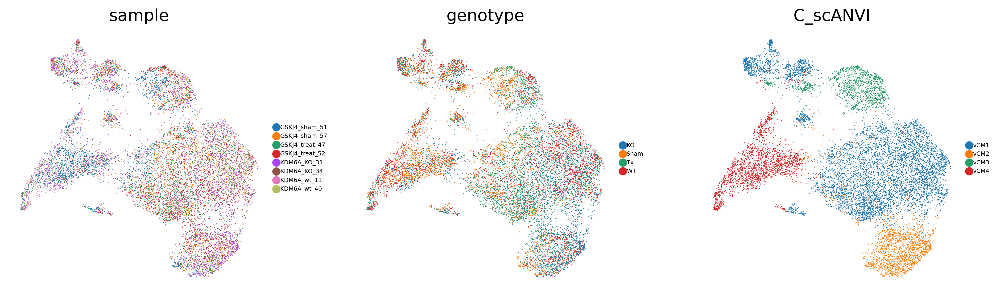

In [4]:
sc.pl.umap(adata, frameon = False, color = ['sample', 'genotype', 'C_scANVI'], size = 2.5, legend_fontsize = 5, ncols = 3)

### Tranform data to scan for transcriptional signatures

In [5]:
adata_log = adata.copy()
sc.pp.normalize_total(adata_log, target_sum = 1e6, exclude_highly_expressed = True)
sc.pp.log1p(adata_log)

normalizing counts per cell The following highly-expressed genes are not considered during normalization factor computation:
['Fhl2', 'Xirp2', 'Ttn', 'Nppa', 'Pcdh7', 'Cacna1c', 'Hbb-bs', 'Lars2', 'Rgs6', 'Ryr2', 'Pde4d', 'Myh6', 'Gm42418', 'Ay036118', 'Slc8a1', 'Malat1', 'Fgf13', 'Dmd', 'Mt-co1', 'Mt-co3']
    finished (0:00:00)


### Calculate DEGs for each cluster

In [25]:
sc.tl.rank_genes_groups(adata_log, 'C_scANVI', method = 'wilcoxon', n_genes = 100, use_raw = False)
result = adata_log.uns['rank_genes_groups']
groups = result['names'].dtype.names
wilcox_markers = pd.DataFrame(
{group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names','logfoldchanges', 'pvals_adj']})
wilcox_markers.head(10)

ranking genes


/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/numpy/core/fromnumeric.py:84: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axis, out=out, **passkwargs)


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:10)


,vCM1_n,vCM1_l,vCM1_p,vCM2_n,vCM2_l,vCM2_p,vCM3_n,vCM3_l,vCM3_p,vCM4_n,vCM4_l,vCM4_p
0,Pcdh7,1.259028,2.263977e-197,Ivns1abp,2.077127,5.062975e-203,Sorbs2,1.830585,0.000000e+00,Mt-co1,6.720370,0.0
1,Dlc1,1.843758,1.741993e-182,Grm1,3.122614,2.674861e-164,Enah,3.778813,4.645689e-288,Mt-nd4,7.771307,0.0
2,Palld,1.165681,1.999637e-160,Prune2,2.395611,1.672663e-131,Ppm1e,5.020664,4.640425e-221,Mt-co3,6.719455,0.0
3,Fgf13,1.402859,2.047764e-155,Ppargc1a,2.326146,1.514245e-127,Xirp2,3.561291,5.806302e-216,Mt-co2,7.317551,0.0
4,Ctnna3,1.222721,2.097478e-155,Cpeb3,1.981759,4.027930e-124,Ankrd1,4.878988,8.279163e-212,Mt-atp6,7.563711,0.0
5,Magi2,1.536585,7.848029e-148,Esrrg,1.940061,4.026651e-119,Tlr4,3.858296,9.414341e-167,Mt-cytb,7.737552,0.0
6,Ank2,1.535059,1.030513e-147,Pde4d,1.360732,1.040626e-117,Pakap-1,3.472835,1.146648e-153,Mt-nd1,7.552417,0.0
7,Tnni3k,1.539833,5.270180e-129,Kcnd2,2.436136,4.516221e-114,Creb5,4.310282,2.409559e-153,Mt-nd2,7.462943,0.0
8,Pde4d,1.361972,3.748529e-120,Pfkfb2,2.634879,9.130577e-110,Lrrfip1,2.552864,3.139821e-152,Mb,5.580807,0.0
9,Malat1,0.781378,6.923459e-109,Cacna1c,1.206688,5.545462e-105,Clic5,3.244675,3.406703e-151,Gm42418,2.685965,0.0


In [26]:
wilcox_markers.to_csv('Kdm6aKO_ALL_GEX_CMC_states_DEG_WRST_ctl240206.csv', index = False, sep = ',')

- Scan for Ferroptosis

In [6]:
ferroptosis_genes = ['Gpx4', 'Slc7a11', 'Slc40a1', 'Ftl1', 'Fth1', 'Acsl4', 'Alox5', 'Ptgs2', 'Nfe2l2', 'Hmox1', 'Sat1']
sc.tl.score_genes(adata_log,
                  gene_list = ferroptosis_genes,
                  score_name = 'ferroptosis_score',
                  random_state = 1712)

computing score 'ferroptosis_score'
    finished: added
    'ferroptosis_score', score of gene set (adata.obs).
    400 total control genes are used. (0:00:00)


/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1207: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:12

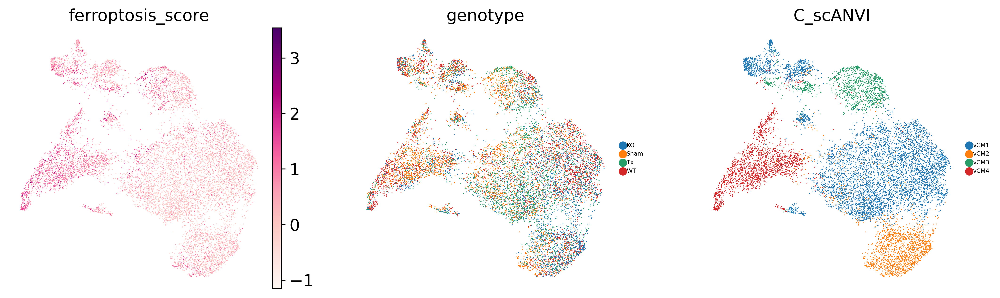

In [7]:
sc.pl.umap(adata_log, 
           frameon = False, 
           color = ['ferroptosis_score', 'genotype', 'C_scANVI'], 
           size = 2.5, 
           legend_fontsize = 5, 
           ncols = 3,
           cmap = 'RdPu')

         Falling back to preprocessing with `sc.pp.pca` and default params.
computing PCA
    with n_comps=50


/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/tools/_dendrogram.py:105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, Categ

    finished (0:00:17)
Storing dendrogram info using `.uns['dendrogram_C_scANVI']`


/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/tools/_dendrogram.py:133: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_df = rep_df.groupby(level=0).mean()
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:748: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


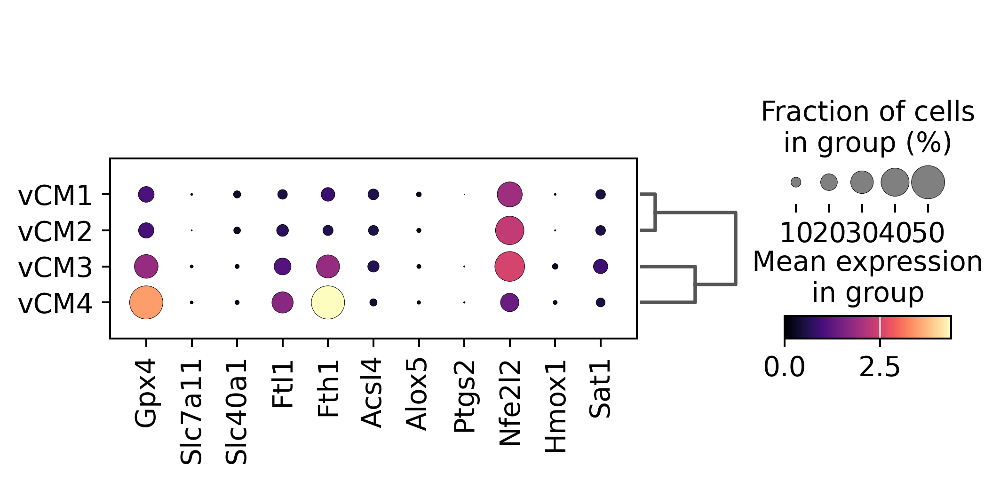

In [8]:
sc.pl.dotplot(adata_log, 
              ferroptosis_genes, 
              groupby = 'C_scANVI', 
              dot_max = 0.5, 
              dendrogram = True,
              cmap = 'magma')

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_genotype']`


/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/tools/_dendrogram.py:105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, Categ

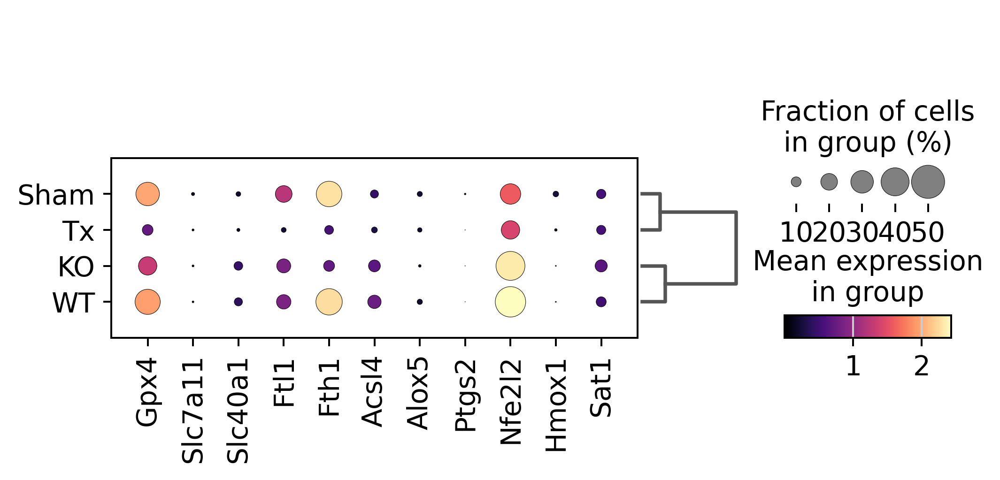

In [9]:
sc.pl.dotplot(adata_log, 
              ferroptosis_genes, 
              groupby = 'genotype', 
              dot_max = 0.5, 
              dendrogram = True,
              cmap = 'magma')

Scan for B2M activity via MHC-I pathway

In [10]:
mhci_genes = ['B2m', 'Tap1', 'Tap2', 'Tapbp', 'Pdia3', 'Calr', 'Psmb9', 'Psmb8']
sc.tl.score_genes(adata_log,
                  gene_list = mhci_genes,
                  score_name = 'MHC-I_score',
                  random_state = 1712)

computing score 'MHC-I_score'
    finished: added
    'MHC-I_score', score of gene set (adata.obs).
    348 total control genes are used. (0:00:00)


/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1207: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:12

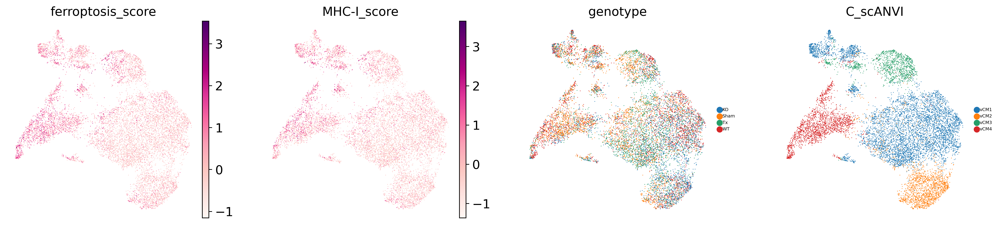

In [11]:
sc.pl.umap(adata_log, 
           frameon = False, 
           color = ['ferroptosis_score', 'MHC-I_score', 'genotype', 'C_scANVI'], 
           size = 2.5, 
           legend_fontsize = 5, 
           ncols = 4,
           cmap = 'RdPu')

/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:748: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, 

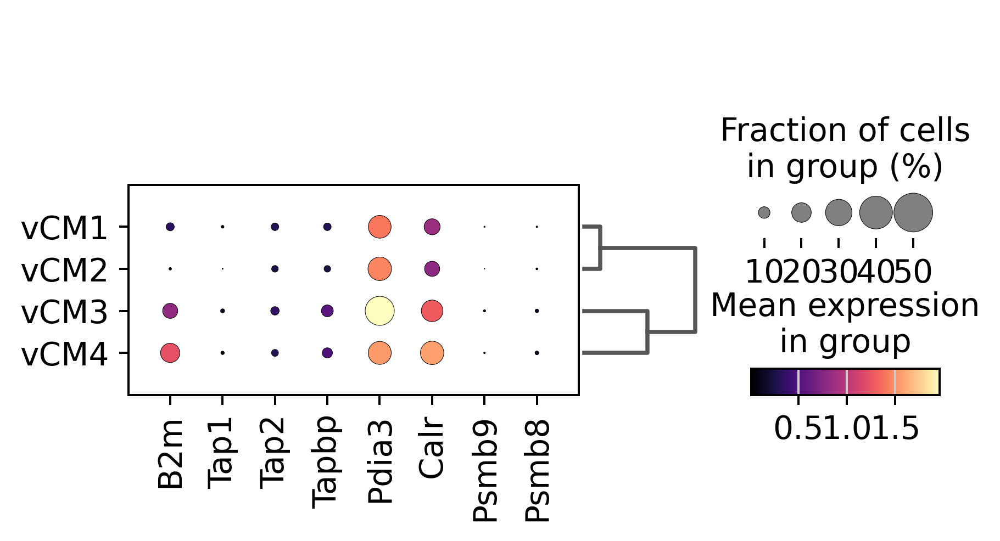

In [12]:
sc.pl.dotplot(adata_log, 
              mhci_genes, 
              groupby = 'C_scANVI', 
              dot_max = 0.5, 
              dendrogram = True,
              cmap = 'magma')

/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:748: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, 

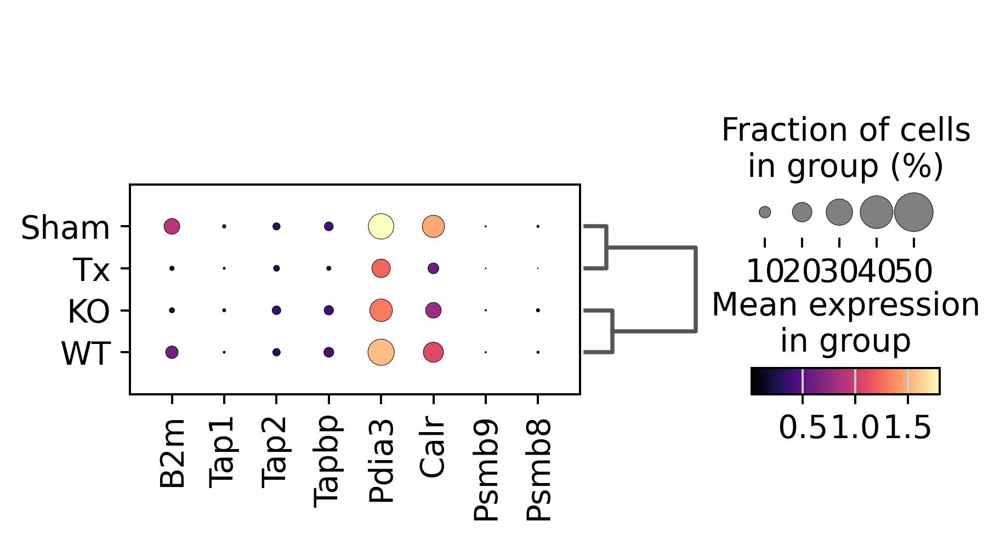

In [13]:
sc.pl.dotplot(adata_log, 
              mhci_genes, 
              groupby = 'genotype', 
              dot_max = 0.5, 
              dendrogram = True,
              cmap = 'magma')

- Scan for IL6 activity

In [14]:
il6_pathway_genes = ['Il6', 'Il6ra', 'Il6st', 'Socs3', 'Stat3', 'Jak1', 'Jak2', 'Bcl3', 'Cish']
sc.tl.score_genes(adata_log,
                  gene_list = il6_pathway_genes,
                  score_name = 'IL6_score',
                  random_state = 1712)

computing score 'IL6_score'
    finished: added
    'IL6_score', score of gene set (adata.obs).
    300 total control genes are used. (0:00:00)


/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1207: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:12

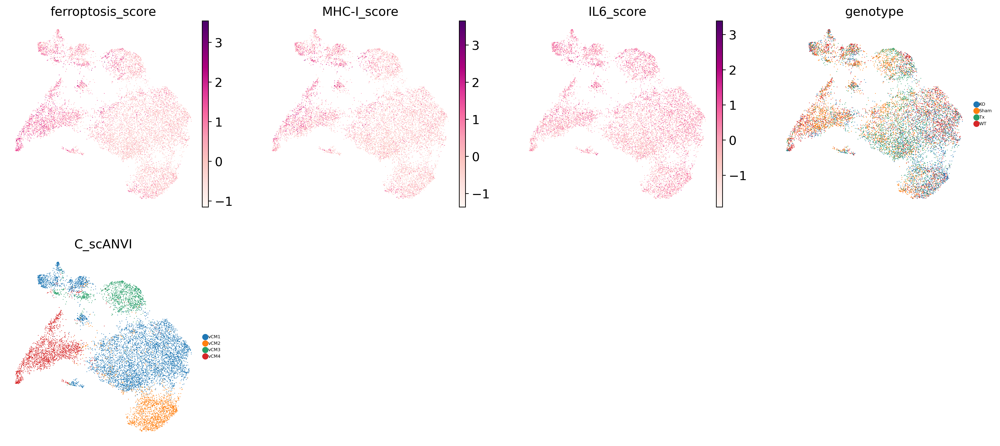

In [15]:
sc.pl.umap(adata_log, 
           frameon = False, 
           color = ['ferroptosis_score', 'MHC-I_score', 'IL6_score', 'genotype', 'C_scANVI'], 
           size = 2.5, 
           legend_fontsize = 5, 
           ncols = 4,
           cmap = 'RdPu')

/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:748: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, 

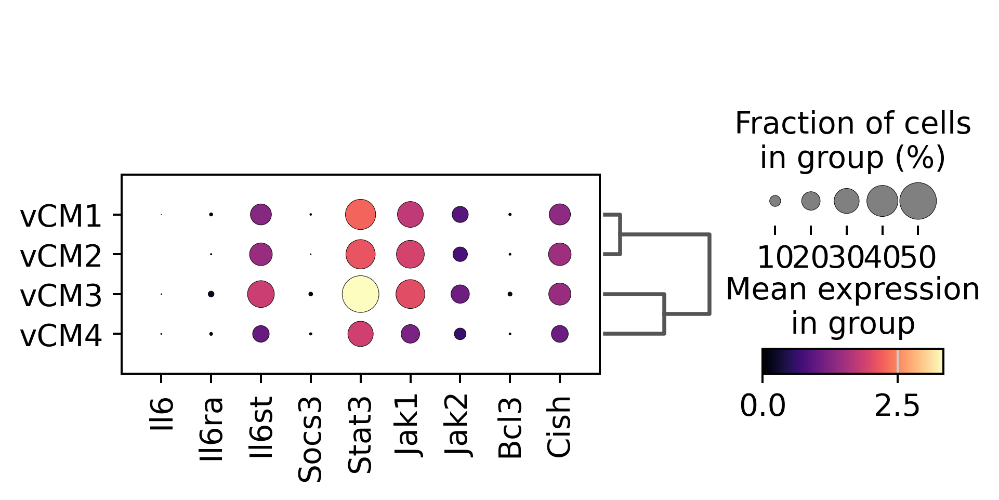

In [16]:
sc.pl.dotplot(adata_log, 
              il6_pathway_genes, 
              groupby = 'C_scANVI', 
              dot_max = 0.5, 
              dendrogram = True,
              cmap = 'magma')

/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:748: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, 

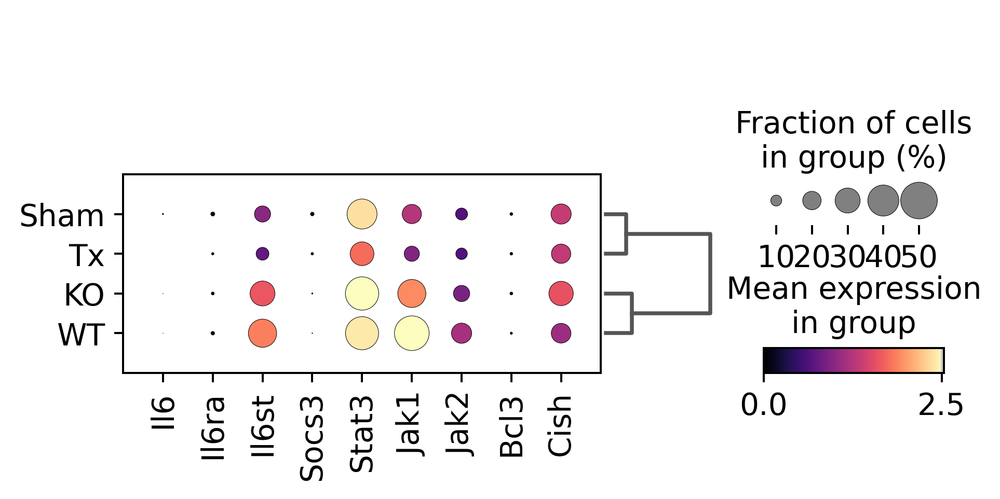

In [17]:
sc.pl.dotplot(adata_log, 
              il6_pathway_genes, 
              groupby = 'genotype', 
              dot_max = 0.5, 
              dendrogram = True,
              cmap = 'magma')

- Scan for IL10 activity

In [18]:
il10_pathway_genes = ['Il10', 'Il10ra', 'Il10rb', 'Jak1', 'Tyk2', 'Stat3', 'Socs3', 'Bcl3']
sc.tl.score_genes(adata_log,
                  gene_list = il10_pathway_genes,
                  score_name = 'IL10_score',
                  random_state = 1712)

computing score 'IL10_score'
    finished: added
    'IL10_score', score of gene set (adata.obs).
    350 total control genes are used. (0:00:00)


/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1207: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:12

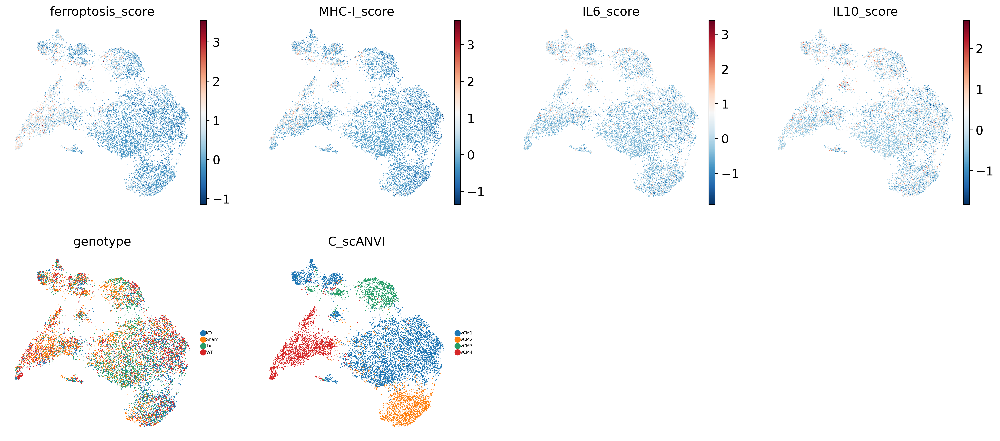

In [19]:
sc.pl.umap(adata_log, 
           frameon = False, 
           color = ['ferroptosis_score', 'MHC-I_score', 'IL6_score', 'IL10_score', 'genotype', 'C_scANVI'], 
           size = 4, 
           legend_fontsize = 5, 
           ncols = 4,
           cmap = 'RdBu_r')

/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1207: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:12

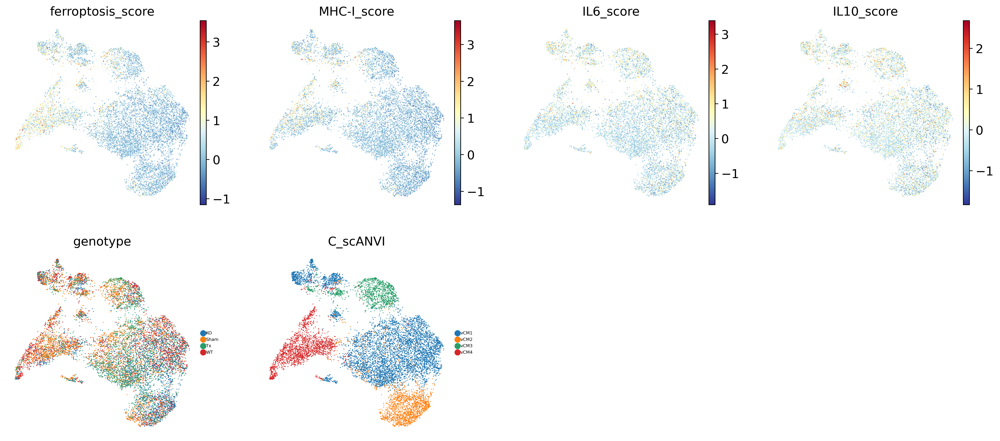

In [20]:
sc.pl.umap(adata_log, 
           frameon = False, 
           color = ['ferroptosis_score', 'MHC-I_score', 'IL6_score', 'IL10_score', 'genotype', 'C_scANVI'], 
           size = 4, 
           legend_fontsize = 5, 
           ncols = 4,
           cmap = 'RdYlBu_r')

- Combined ferroptosis score

In [21]:
ferroptosis_plus_genes = [
    'Aco2', 'Acsl4', 'Alox12', 'Alox15', 'Alox5', 'Atg4b', 'Atg5', 'Atg7', 
    'Cdkn1a', 'Cs', 'Cybb', 'Dlst', 'Fh1', 'Fth1', 'Ftl1', 
    'Gclc', 'Gclm', 'Gls2', 'Gpx4', 'Hmox1', 'Hspa1a', 'Hspa1b', 'Hspb1', 
    'Idh2', 'Lpcat3', 'Map1lc3a', 'Map1lc3b', 'Mdm2', 'Nfe2l2', 'Nox1', 'Nox4', 
    'Prdx1', 'Ptgs2', 'Sat1', 'Sdhb', 'Slc3a2', 'Slc40a1', 'Slc7a11', 
    'Sod1', 'Sod2', 'Sqstm1', 'Tfrc'
]
sc.tl.score_genes(adata_log,
                  gene_list = ferroptosis_plus_genes,
                  score_name = 'Ferroptosis+_score',
                  random_state = 1712)

computing score 'Ferroptosis+_score'
    finished: added
    'Ferroptosis+_score', score of gene set (adata.obs).
    599 total control genes are used. (0:00:00)


/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1207: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:12

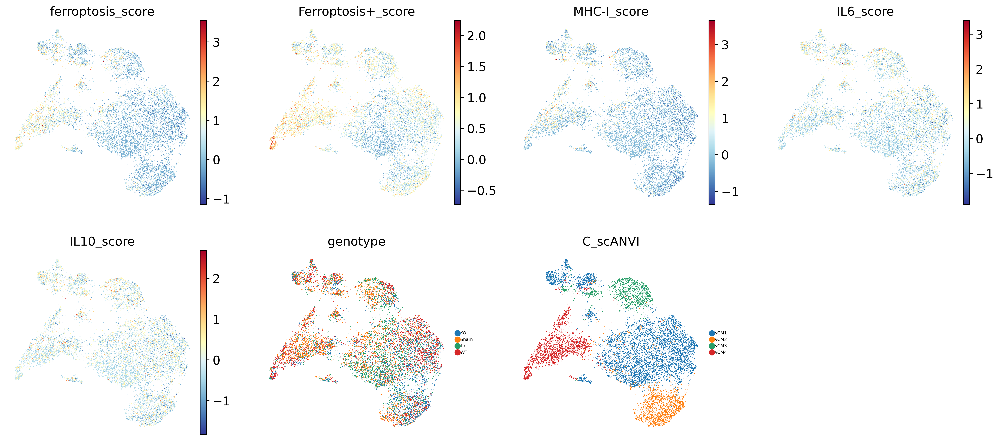

In [22]:
sc.pl.umap(adata_log, 
           frameon = False, 
           color = ['ferroptosis_score', 'Ferroptosis+_score', 'MHC-I_score', 'IL6_score', 'IL10_score', 'genotype', 'C_scANVI'], 
           size = 3, 
           legend_fontsize = 5, 
           ncols = 4,
           cmap = 'RdYlBu_r')

/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:748: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, 

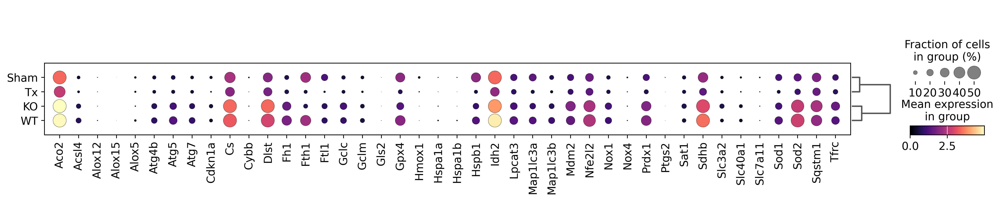

In [23]:
sc.pl.dotplot(adata_log, 
              ferroptosis_plus_genes, 
              groupby = 'genotype', 
              dot_max = 0.5, 
              dendrogram = True,
              cmap = 'magma')

/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:748: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, 

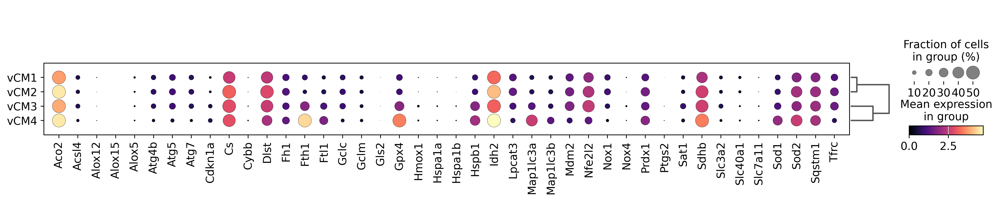

In [24]:
sc.pl.dotplot(adata_log, 
              ferroptosis_plus_genes, 
              groupby = 'C_scANVI', 
              dot_max = 0.5, 
              dendrogram = True,
              cmap = 'magma')